In [1]:
import pandas as pd
import numpy as np 
import tensorflow as tf

from tensorflow.keras import datasets, layers, models
from tensorflow.keras.preprocessing.image import ImageDataGenerator

from sklearn.model_selection import train_test_split

import cv2
from tqdm import tqdm


import matplotlib.pyplot as plt


import os 
# import glob

tqdm.pandas()

C:\ProgramData\Anaconda3\lib\site-packages\tqdm\std.py:668: FutureWarning: The Panel class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  from pandas import Panel


In [2]:
labels = pd.read_csv('train.csv')

In [3]:
display(labels.head())
labels.info()

,image_id,healthy,multiple_diseases,rust,scab
0,Train_0,0,0,0,1
1,Train_1,0,1,0,0
2,Train_2,1,0,0,0
3,Train_3,0,0,1,0
4,Train_4,1,0,0,0


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1821 entries, 0 to 1820
Data columns (total 5 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   image_id           1821 non-null   object
 1   healthy            1821 non-null   int64 
 2   multiple_diseases  1821 non-null   int64 
 3   rust               1821 non-null   int64 
 4   scab               1821 non-null   int64 
dtypes: int64(4), object(1)
memory usage: 71.3+ KB


In [4]:
# image to array function 
def load_image(image_id):
    path = '{}.jpg'.format(image_id)
    image = cv2.imread('images/raw/{}'.format(path))
    return cv2.cvtColor(image, cv2.COLOR_BGR2RGB)



train_images = labels.loc[:,'image_id'].progress_apply(load_image)

100%|██████████████████████████████████████████████████████████████████████████████| 1821/1821 [00:41<00:00, 44.28it/s]


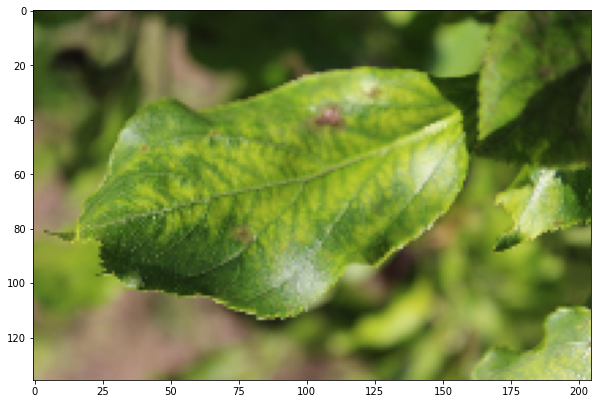

In [5]:
# Look at an image
f, ax = plt.subplots(figsize=(10,10))
ax.imshow(cv2.resize(train_images[0], (205,136)))
plt.show()

In [6]:
# Look at training image shape
np.shape(train_images[0])

(1365, 2048, 3)

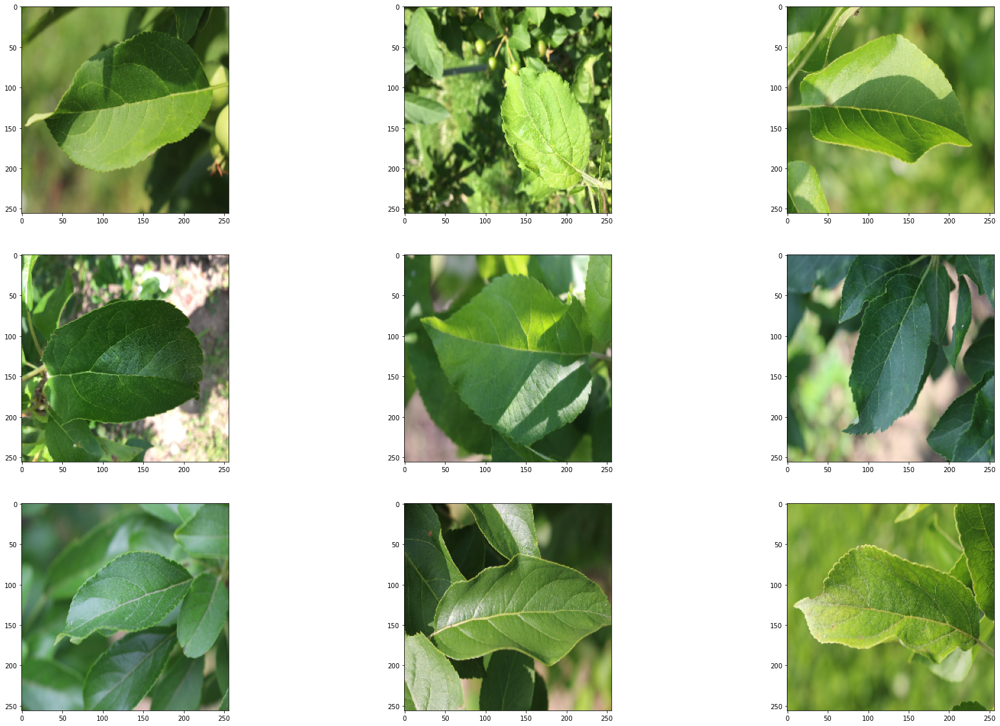

In [7]:
def plot_image(plot_ax, image_index):
        return plot_ax.imshow(cv2.resize(train_images[image_index], (256,256)))
def show_leaves(condition):
    rows, cols = 3, 3
    f, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(30,20))
    ax = np.ravel(ax)
    img_labels = labels.loc[labels['{}'.format(condition)] == 1,'image_id'].values
    np.random.shuffle(img_labels)
    for index, image in enumerate(img_labels):
        if index == (rows * cols):
            break
        image_index = int(image.split('_')[1])
        plot_image(ax[index], image_index)
    plt.show()
    
    
    
show_leaves('healthy')
                                  

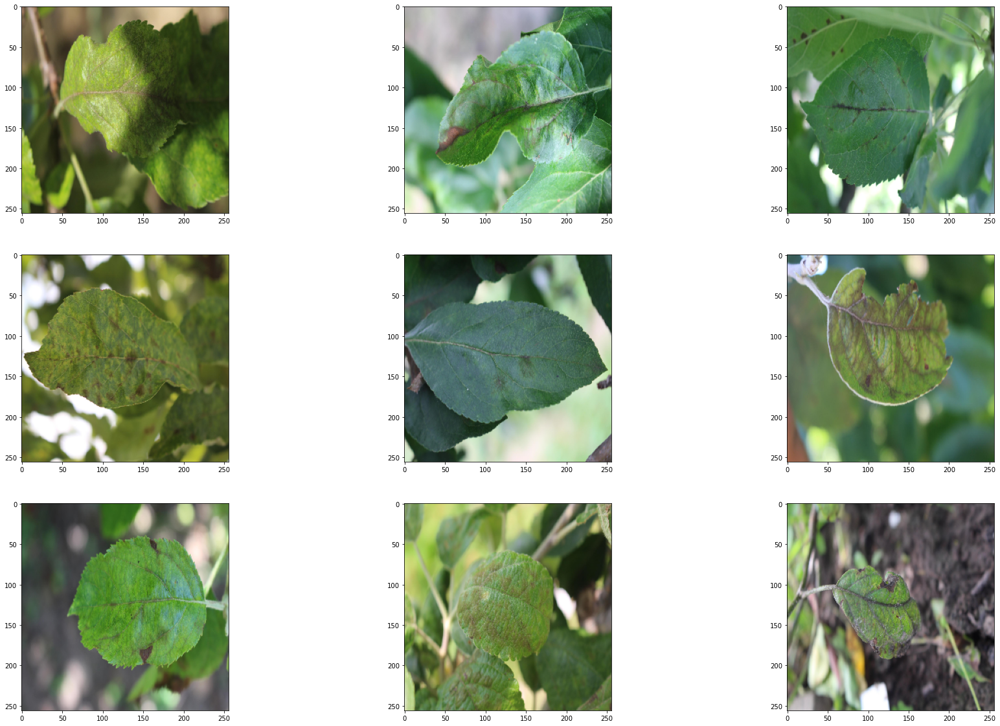

In [8]:
show_leaves('scab')

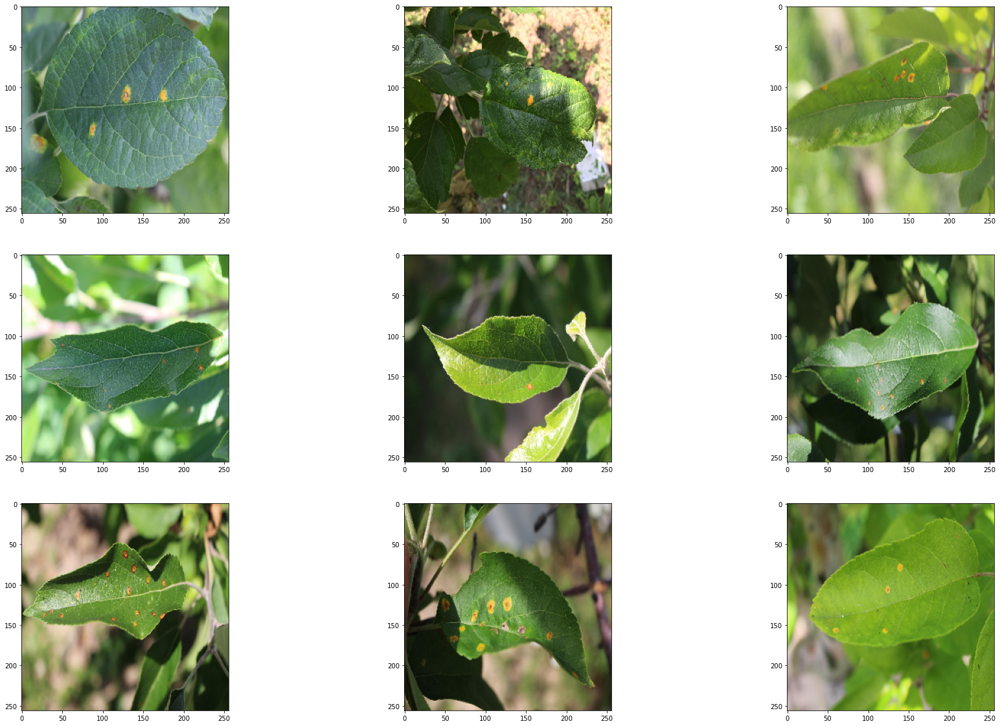

In [9]:
show_leaves('rust')

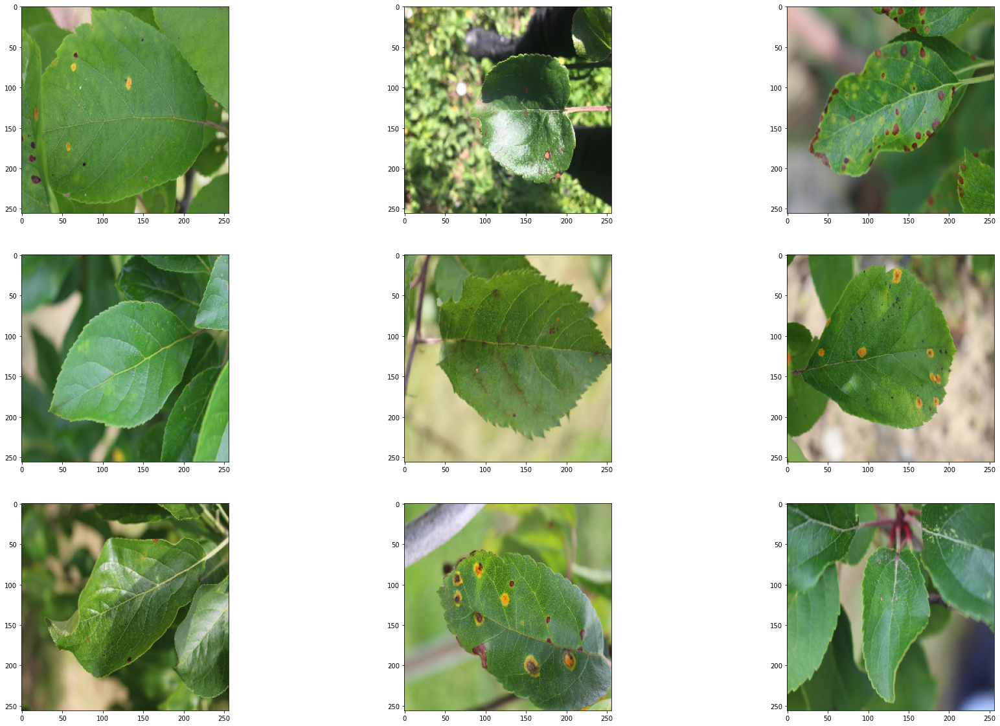

In [10]:
show_leaves('multiple_diseases')

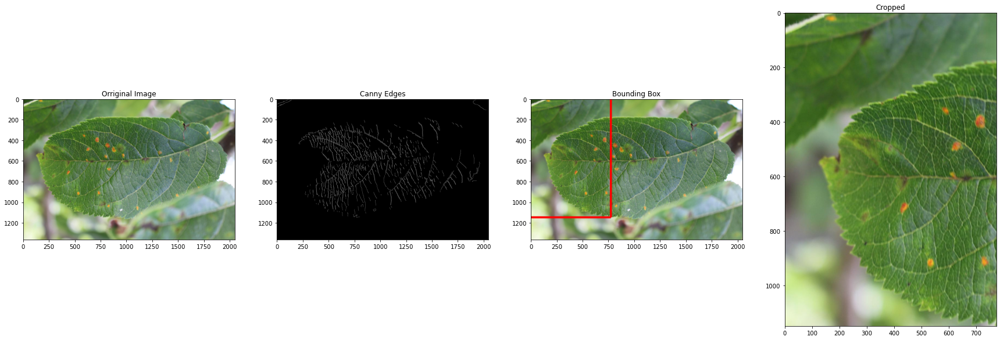

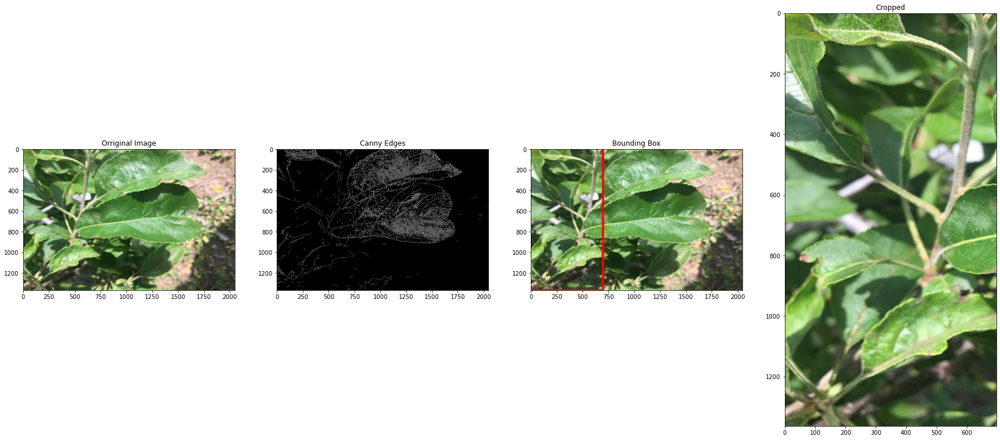

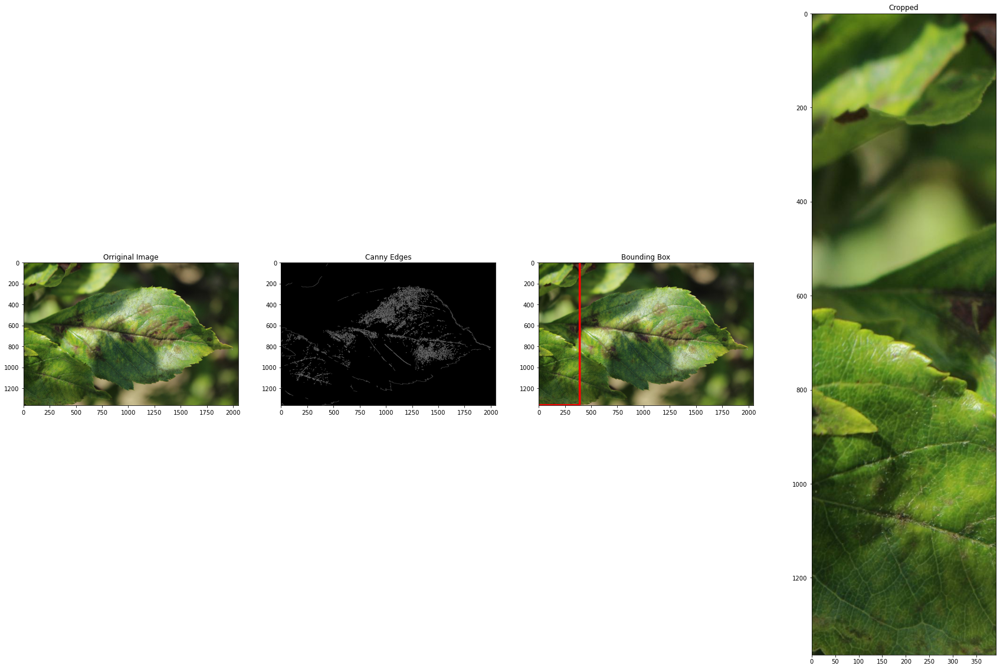

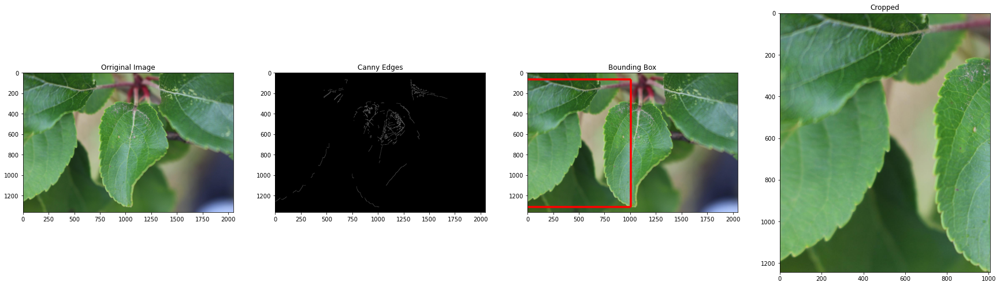

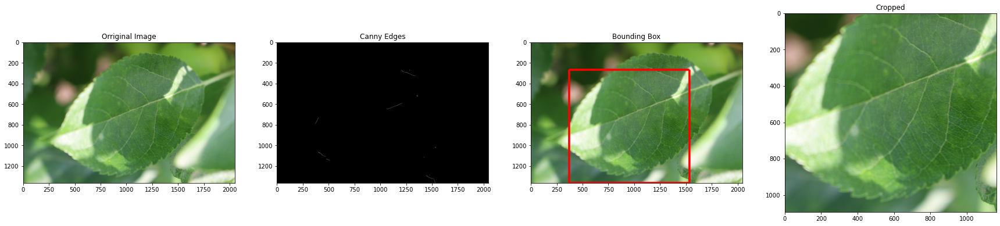

In [14]:
#Canny Edge detection
#current cropping method is unreliable, wont feed cropped images to network
def show_edges(img):
    emb_img = img.copy()
    edges = cv2.Canny(img, 100, 200)
    edge_coors = []
    for i in range(edges.shape[0]):
        for j in range(edges.shape[1]):
            if edges[i][j] != 0:
                edge_coors.append((i,j))

    row_min = edge_coors[np.argsort([coor[0] for coor in edge_coors])[0]][0]
    row_max = edge_coors[np.argsort([coor[0] for coor in edge_coors])[-1]][0]
    col_min = edge_coors[np.argsort([coor[1] for coor in edge_coors])[0]][1]
    col_max = edge_coors[np.argsort([coor[0] for coor in edge_coors])[-1]][1]
    new_img = img[row_min:row_max, col_min:col_max]

    emb_img[row_min-10:row_min+10, col_min:col_max] = [255,0,0]
    emb_img[row_max-10:row_max+10, col_min:col_max] = [255,0,0]
    emb_img[row_min:row_max, col_min-10:col_min+10] = [255,0,0]
    emb_img[row_min:row_max, col_max-10:col_max+10] = [255,0,0]

    f, a = plt.subplots(nrows=1, ncols=4, figsize=(30,20))
    a[0].imshow(img)
    a[0].set_title("Orriginal Image")
    a[1].set_title('Canny Edges')
    a[1].imshow(edges,cmap='gray')
    a[2].imshow(emb_img)
    a[2].set_title('Bounding Box')
    a[3].imshow(new_img)
    a[3].set_title('Cropped')
    
    
    
    
    
for i in np.random.randint(low=0, high=len(train_images), size=5):    
    show_edges(train_images[i])

[INFO] applying small_blur kernel


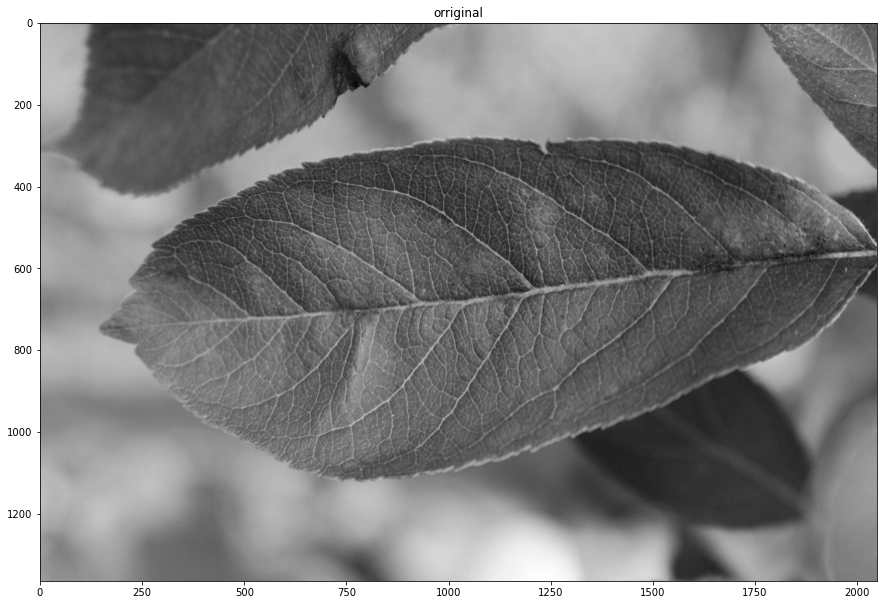

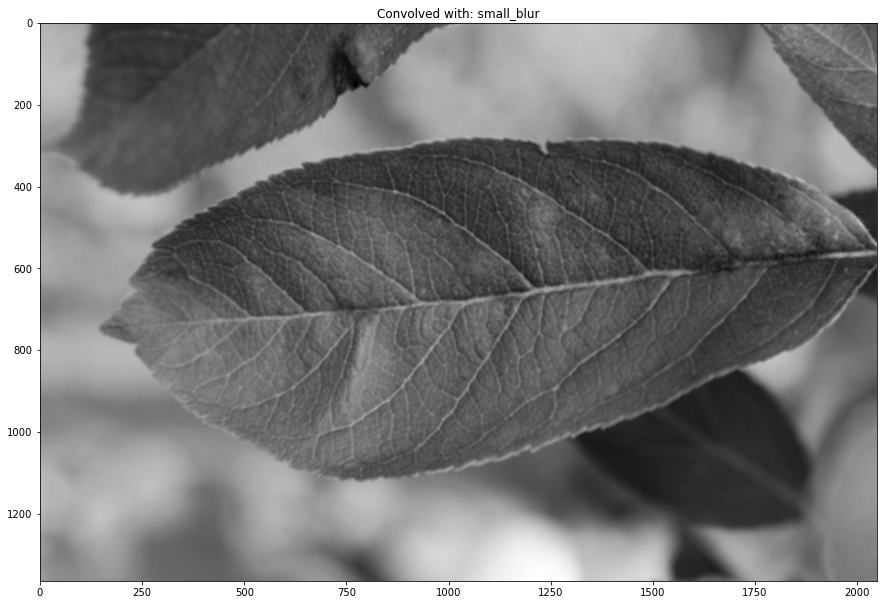

[INFO] applying large_blur kernel


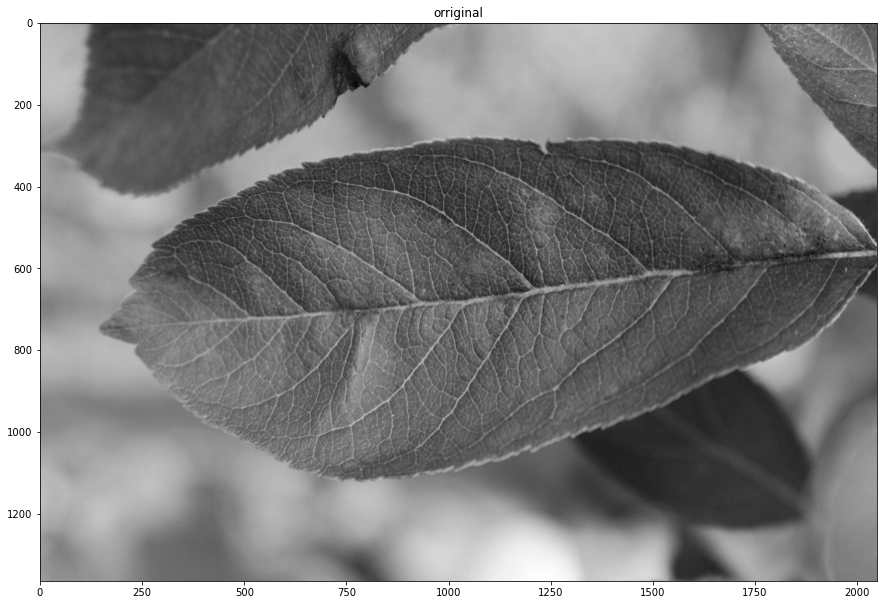

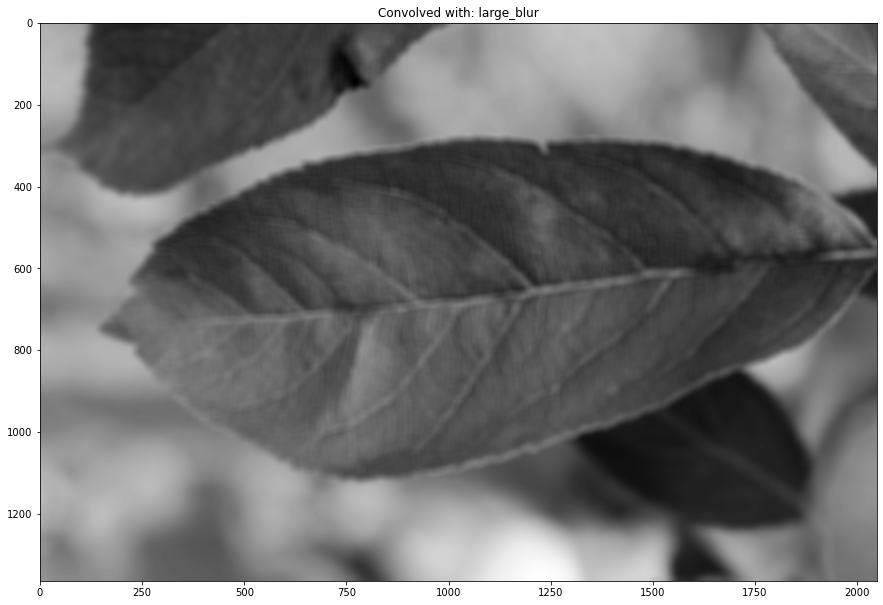

[INFO] applying sharpen kernel


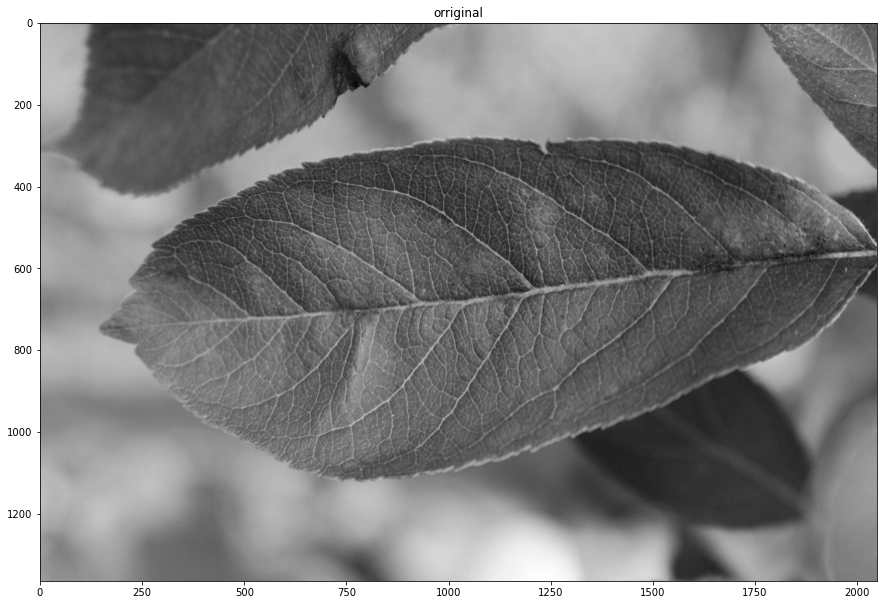

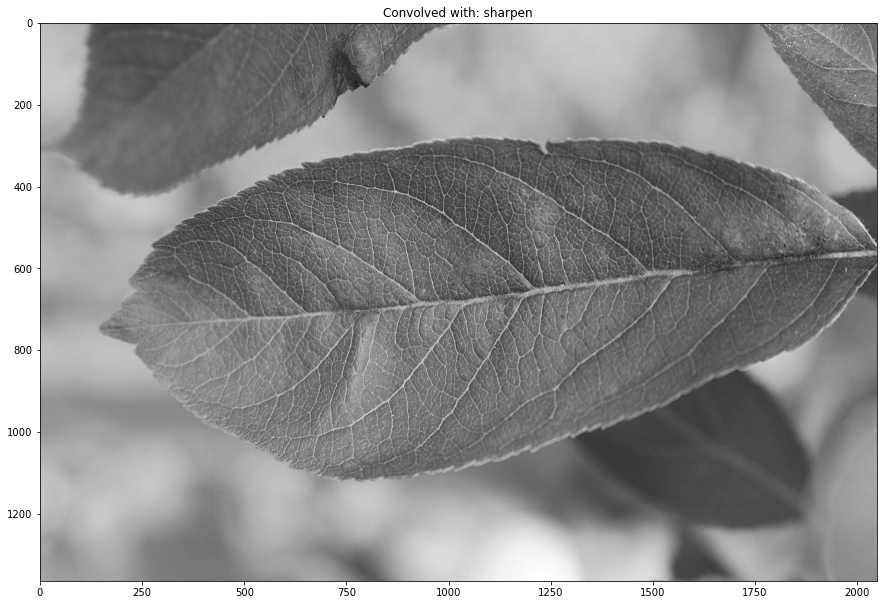

[INFO] applying laplacian kernel


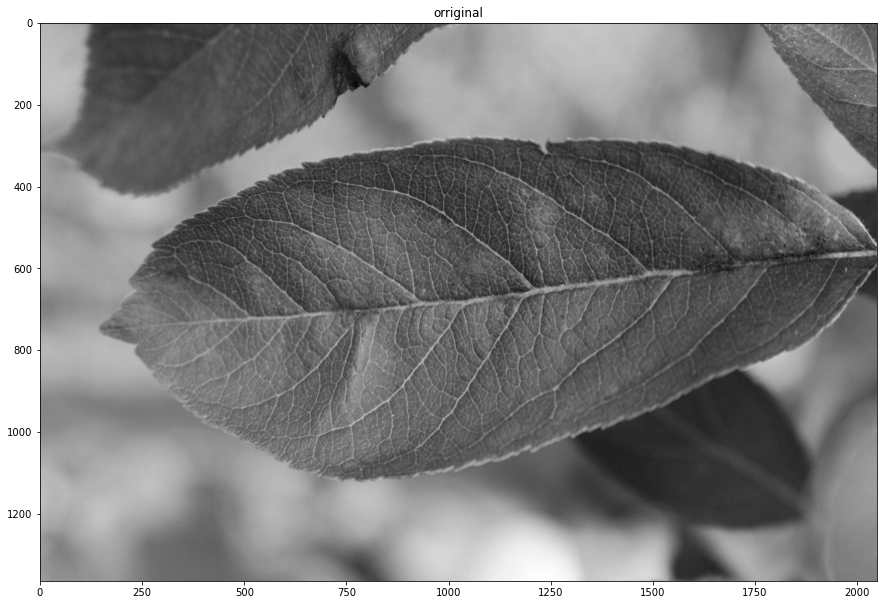

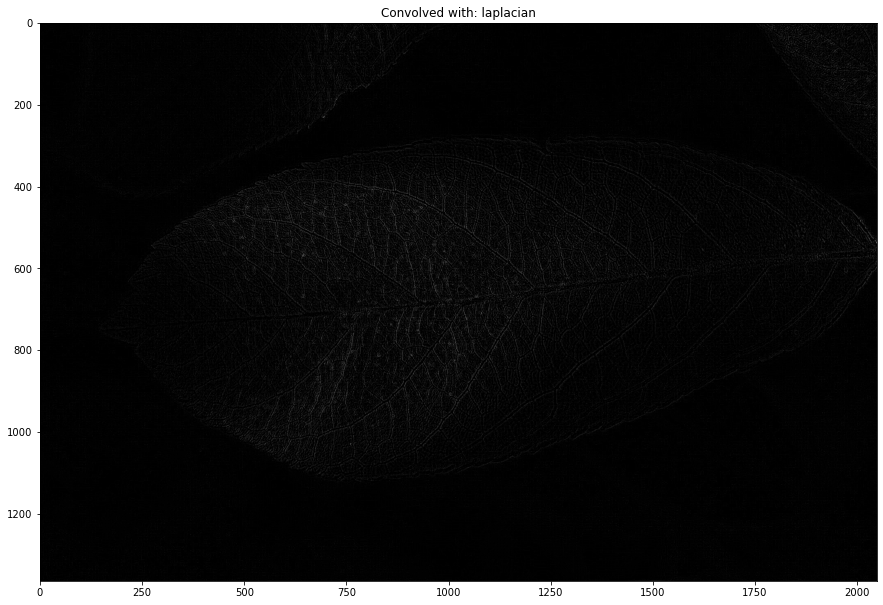

[INFO] applying sobel_x kernel


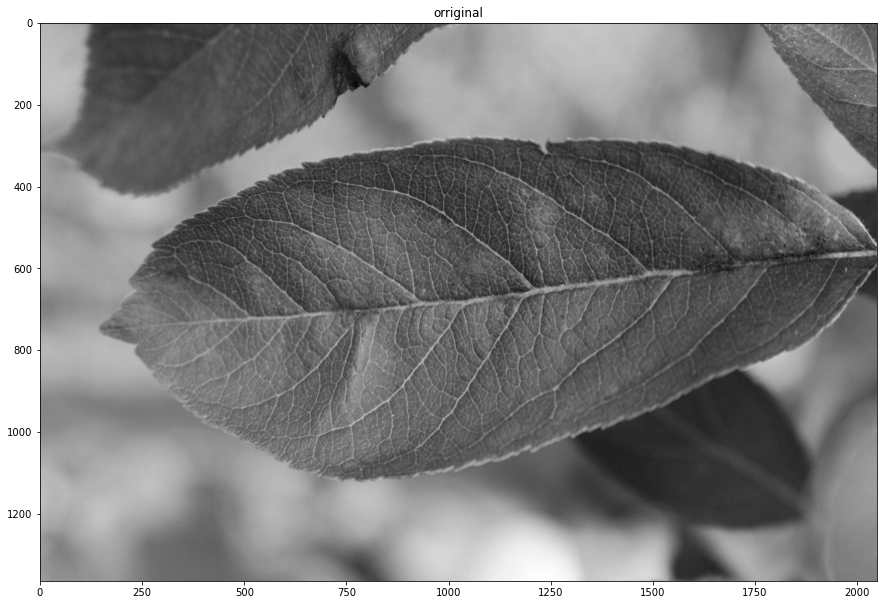

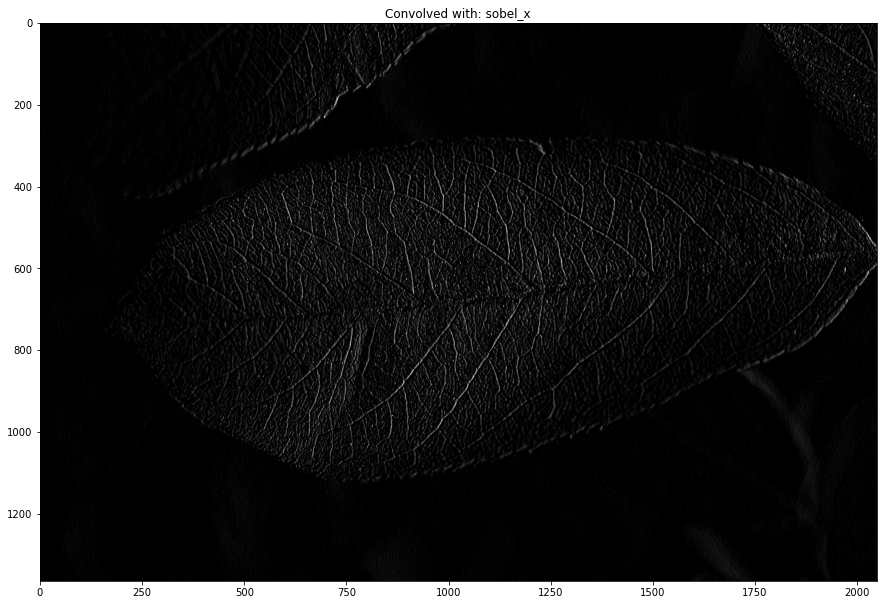

[INFO] applying sobel_y kernel


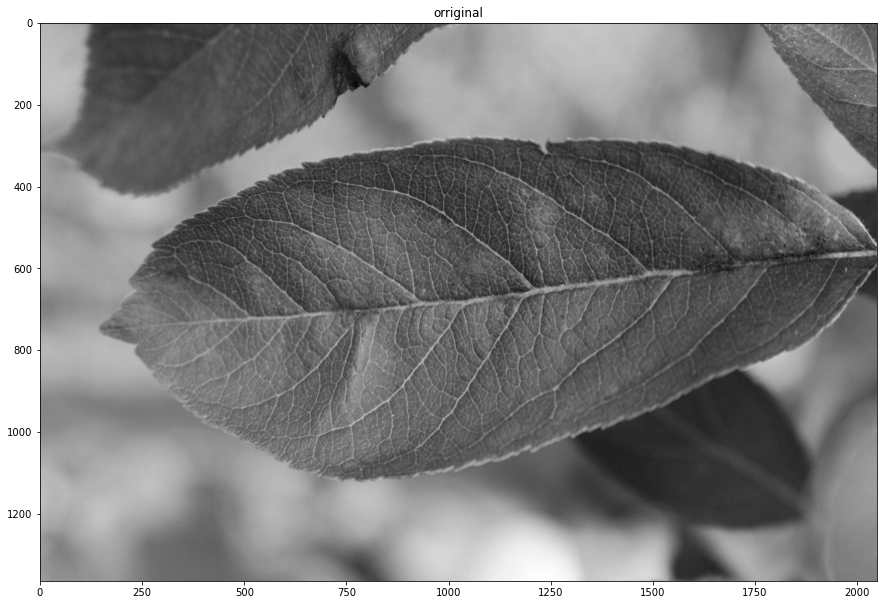

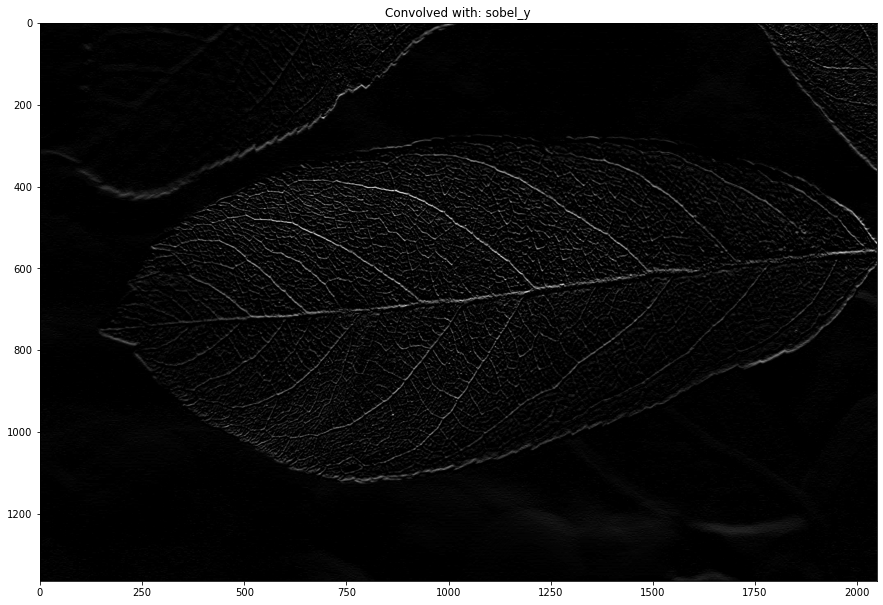

In [15]:
# from https://www.pyimagesearch.com/2016/07/25/convolutions-with-opencv-and-python/
#visualize convolution 
smallBlur = np.ones((7, 7), dtype="float") * (1.0 / (7 * 7))
largeBlur = np.ones((21, 21), dtype="float") * (1.0 / (21 * 21))

# construct a sharpening filter
sharpen = np.array((
[0, -1, 0],
[-1, 5, -1],
[0, -1, 0]), dtype="int")
# construct the Laplacian kernel used to detect edge-like
# regions of an image
laplacian = np.array((
[0, 1, 0],
[1, -4, 1],
[0, 1, 0]), dtype="int")

# construct the Sobel x-axis kernel
sobelX = np.array((
[-1, 0, 1],
[-2, 0, 2],
[-1, 0, 1]), dtype="int")

# construct the Sobel y-axis kernel
sobelY = np.array((
[-1, -2, -1],
[0, 0, 0],
[1, 2, 1]), dtype="int")

kernelBank = (
("small_blur", smallBlur),
("large_blur", largeBlur),
("sharpen", sharpen),
("laplacian", laplacian),
("sobel_x", sobelX),
("sobel_y", sobelY)
)

gray = cv2.cvtColor(train_images[253], cv2.COLOR_BGR2GRAY)
for (kernelName, kernel) in kernelBank:
# apply the kernel to the grayscale image using both
# our custom `convole` function and OpenCV's `filter2D`
# function
    print("[INFO] applying {} kernel".format(kernelName))
    opencvOutput = cv2.filter2D(gray, -1, kernel)

# show the output images
    plt.figure(figsize=(15,15))
    plt.imshow(gray,cmap='gray')
    plt.title('orriginal')
    plt.show()
    plt.figure(figsize=(15,15))
    plt.imshow(opencvOutput,cmap='gray')
    plt.title('Convolved with: {}'.format(kernelName))
    plt.show()

# Now starting to build a model 

In [6]:



# image to array function 
def load_image(image_id):
    image = cv2.imread(image_id)
    image = cv2.resize(image, (215, 215))
    return np.float32(image)


def create_paths(img):
    return 'images/{}.jpg'.format(img)


labels['path'] = labels.image_id.progress_apply(create_paths)

# Following lines are for a more memory intensive method that doesn't use the tf.keras image generator 
# 
# all_train_paths = labels.image_id.progress_apply(load_image).values
# all_train_labels = labels.loc[:,labels.columns != 'image_id'].values

# print(all_train_paths.shape)
# print(all_train_labels[::5])
# train_paths, valid_paths, train_labels, valid_labels = train_test_split(all_train_paths, all_train_labels, test_size=0.3,
#                                                                        random_state=42, stratify=all_train_labels)

100%|██████████████████████████████████████████████████████████████████████████| 1821/1821 [00:00<00:00, 608737.35it/s]


In [5]:
def decode_image(filename, label=None, image_size=(512,512)):
    bits = tf.io.read_file(filename)
    image = tf.image.decode_jpeg(bits, channels=3)
    image = tf.cast(image, tf.float32) / 255
    image = tf.image.resize(image, image_size)
    if label is None:
        return image
    else:
        return image, label 
    
    
    
def data_rotate(image):
    rotates = [cv2.ROTATE_90_CLOCKWISE, cv2.ROTATE_180, cv2.ROTATE_90_COUNTERCLOCKWISE]
    index = np.random.randint(0,len(rotates),1)
    image_rotate = cv2.rotate(image, rotateCode=rotates[index[0]])
    return image_rotate

def data_flip(image):
    flipcodes = [0,1,-1]
    index = np.random.randint(0,len(flipcodes),1)
    image_flip = cv2.flip(image, flipCode=flipcodes[index[0]])
    return image_flip

In [103]:
#Probably a better way to get the shape right but need the shape of inputs to be 
#(number images, numrows, numcols, numchannels)

# trainX_src, valX_src = np.array([i for i in train_paths],dtype='float32'), np.array([i for i in valid_paths],dtype='float32')
# trainX_rot, valX_rot = np.array([data_rotate(i) for i in train_paths]), np.array([data_rotate(i) for i in valid_paths],dtype='float32')
# trainX_flip, valX_flip = np.array([data_flip(i) for i in train_paths]), np.array([data_flip(i) for i in valid_paths],dtype='float32')
# trainX_ = np.stack((trainX_src, trainX_rot, trainX_flip),axis=0)
# valX_ = np.stack((valX_src, valX_rot, valX_flip),axis=0)
# train_labels_, valid_lables_ = np.stack((train_labels, train_labels, train_labels)), np.stack((valid_labels, valid_labels, valid_labels))  

## PART OF MEMEORY INTESIVE VERSION CURRENTLY COMMENTED OUT

In [104]:
# PART OF COMMENTED OUT VERSION

# trainX = trainX_.reshape(-1,215,215,3)
# valX = valX_.reshape(-1,215,215,3)
# train_labels = train_labels_.reshape(-1,4)
# valid_labels = valid_lables_.reshape(-1,4)

In [7]:

gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
  # Restrict TensorFlow to only allocate 2GB of memory on the first GPU
    try:
        tf.config.experimental.set_virtual_device_configuration(
            gpus[0],
            [tf.config.experimental.VirtualDeviceConfiguration(memory_limit=2000)])
        logical_gpus = tf.config.experimental.list_logical_devices('GPU')
        print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
    except RuntimeError as e:
    # Virtual devices must be set before GPUs have been initialized
        print(e)
    
    
    
# config = tf.ConfigProto()
# config.gpu_options.allow_growth = True
# session = tf.Session(config=config)

1 Physical GPUs, 1 Logical GPUs


In [81]:
#Alternate method using tensorflow built in data genorators while training rather than having to store all the flipped
#and modified images in memory and in real time per batch
#seems to use less training data per epoch this way though, not currently exactly sure how ImageDataGen functions 


X = labels.loc[:,'path']
y = labels.loc[:, labels.columns[1:5]]

X_train, X_test, y_train, y_test = train_test_split(X,y,random_state=13,stratify=y,test_size=0.25)

# zippedtrain = zip(X_train,y_train)
# zippedtest = zip(X_test,y_test)
# train_df = pd.DataFrame({'path':X_train,'class':[list(i) for i in y_train]})
# test_df = pd.DataFrame({'path':X_test,'class':[list(i) for i in y_test]})

train_df = pd.DataFrame(X_train).join(pd.DataFrame(y_train))
test_df = pd.DataFrame(X_test).join(pd.DataFrame(y_test))

train_df.head()

,path,healthy,multiple_diseases,rust,scab
1601,images/Train_1601.jpg,1,0,0,0
1414,images/Train_1414.jpg,1,0,0,0
1701,images/Train_1701.jpg,0,0,0,1
516,images/Train_516.jpg,0,0,1,0
1708,images/Train_1708.jpg,0,1,0,0


In [15]:
batch = 15

imgH = 256
imgW = 256

image_generator = ImageDataGenerator(rescale = 1./255, rotation_range=45, width_shift_range=None,
                                    height_shift_range=None, horizontal_flip=True, vertical_flip=True,zoom_range=0)
val_image_gen = ImageDataGenerator(rescale=1./255)
valGen = val_image_gen.flow_from_dataframe(test_df,directory=None, x_col='path',
                                           y_col=['healthy','multiple_diseases','rust','scab'],
                                          batch_size=batch, class_mode='raw', target_size=(imgH,imgW))

traindataGen = image_generator.flow_from_dataframe(train_df, directory=None, x_col='path', 
                                                   y_col=['healthy','multiple_diseases','rust','scab'],
                                                  target_size=(imgH,imgW), batch_size=batch, class_mode='raw')
# train_data_gen = train_image_generator.flow_from_directory(batch_size=batch, directory='images/', shuffle=True,
#                                                           target_size=(imgH, imgW),
#                                                           class_mode='multi-class')

Found 547 validated image filenames.
Found 1274 validated image filenames.


[0 0 1 0]


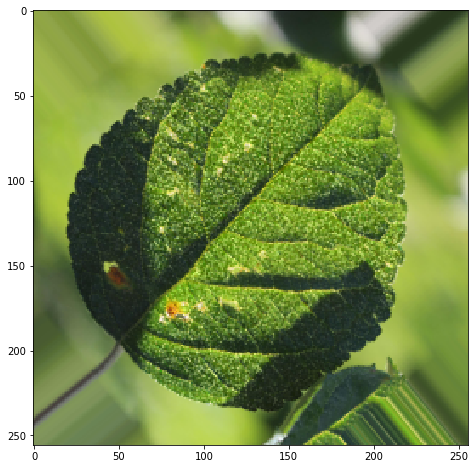

[1 0 0 0]


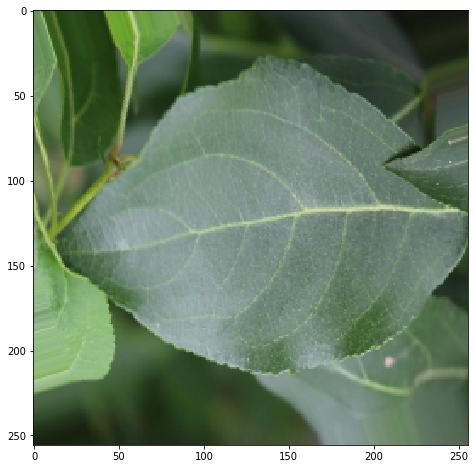

[0 0 1 0]


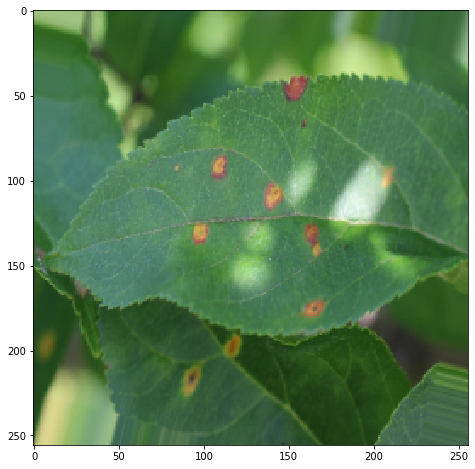

[0 0 1 0]


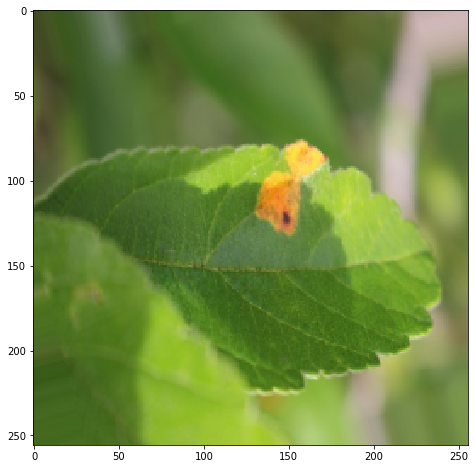

[0 0 1 0]


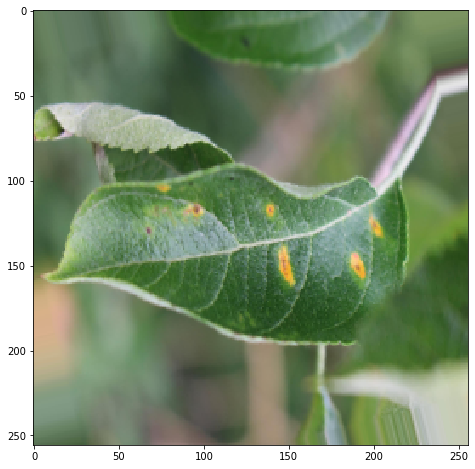

[1 0 0 0]


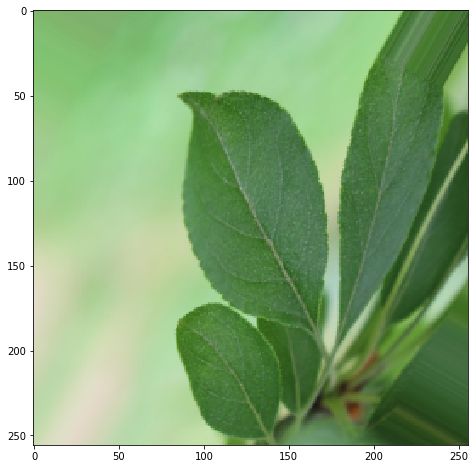

[0 0 1 0]


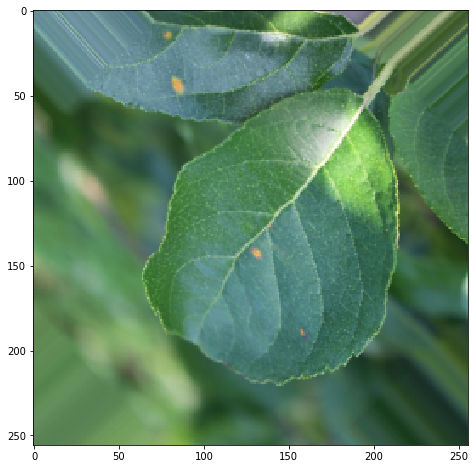

[0 1 0 0]


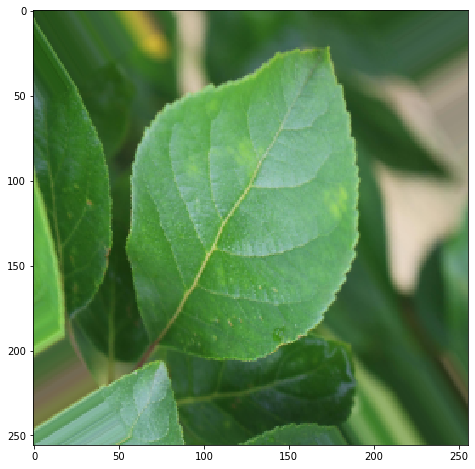

[0 0 1 0]


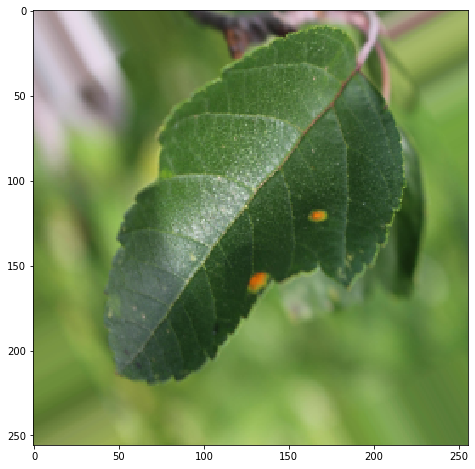

[0 0 0 1]


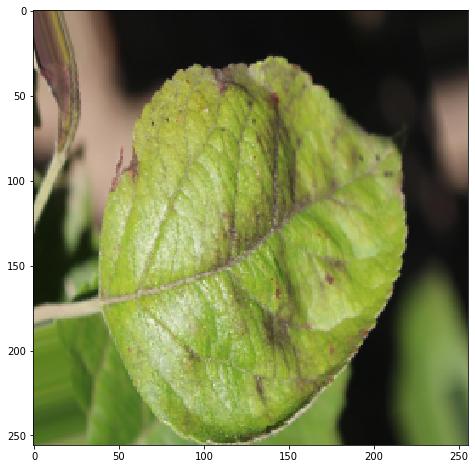

[1 0 0 0]


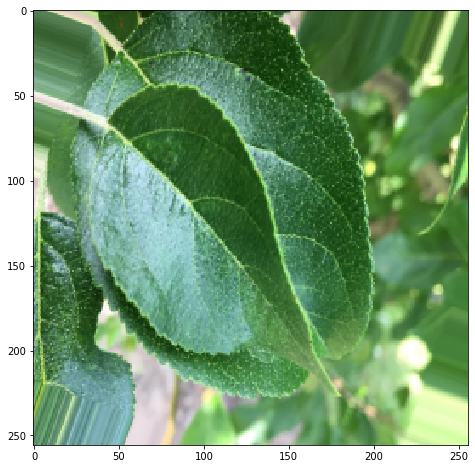

[0 0 1 0]


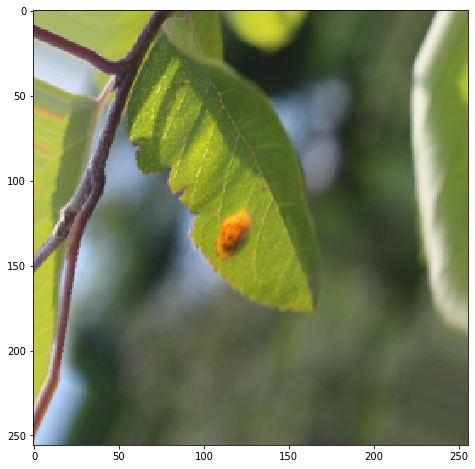

[0 1 0 0]


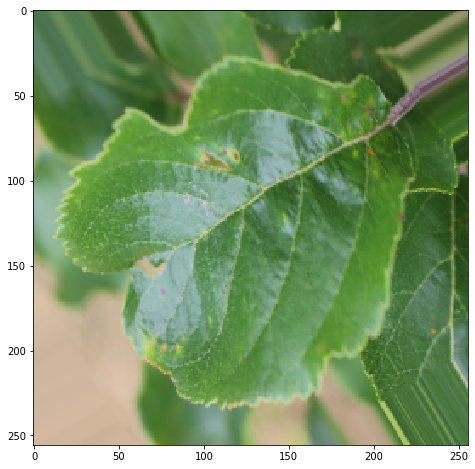

[0 0 0 1]


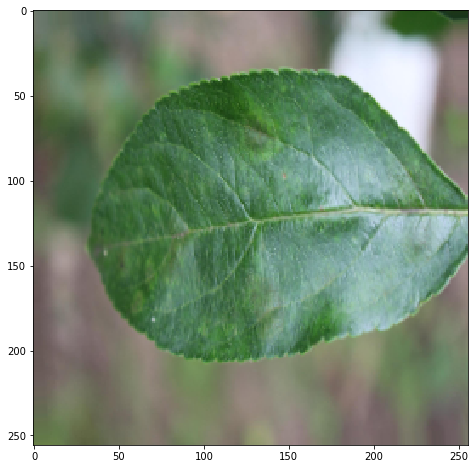

[0 0 0 1]


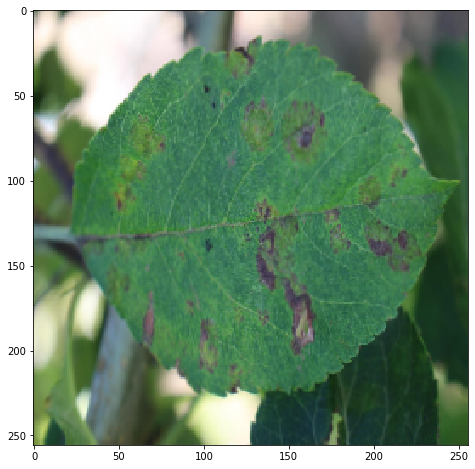

[0 0 1 0]


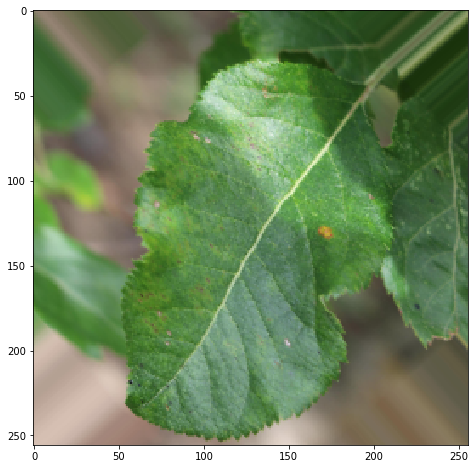

In [17]:
# show some of the aumented images

counter = 0
for x, label in traindataGen:
    counter += 1
    if counter == 5:
        break
    print(label[1])
    plt.figure(figsize=(8,8))
    plt.imshow(x[1])
    plt.show()
    print(label[2])
    plt.figure(figsize=(8,8))
    plt.imshow(x[2])
    plt.show()
    print(label[3])
    plt.figure(figsize=(8,8))
    plt.imshow(x[3])
    plt.show()
    print(label[4])
    plt.figure(figsize=(8,8))
    plt.imshow(x[4])
    plt.show()

In [20]:


# creating a baseline somewhat simple deep CNN for image recognition
# Want to look into kernel initializer, not sure if the kernel values change through learning currently in a CNN 
model = models.Sequential()
model.add(layers.Conv2D(filters=16,kernel_size=(3,3), activation='relu', input_shape=(imgH, imgW,3), padding='same',
                       dilation_rate=3))
model.add(layers.MaxPooling2D())
model.add(layers.Dropout(0.1))
model.add(layers.Conv2D(32, (3,3), activation='relu', padding='valid'))
model.add(layers.MaxPooling2D())
model.add(layers.Dropout(0.1))
model.add(layers.Conv2D(32, (3,3), activation='relu', padding='same'))
model.add(layers.MaxPooling2D())
model.add(layers.Dropout(0.1))

model.add(layers.Flatten())
model.add(layers.Dense(512, activation='relu'))
model.add(layers.Dense(y_train.shape[1], activation='softmax'))

model.summary()





STEP_SIZE_TRAIN=traindataGen.n//traindataGen.batch_size
STEP_SIZE_VALID=valGen.n//valGen.batch_size


epochs = 50
model.compile(optimizer='adam',
             loss='categorical_crossentropy',
             metrics=['categorical_accuracy'])

history = model.fit_generator(generator=traindataGen, 
                              epochs=epochs,
                   validation_data=valGen,steps_per_epoch=STEP_SIZE_TRAIN,validation_steps=STEP_SIZE_VALID, verbose=2)
# history = model.fit(trainX, train_labels, epochs=epochs, validation_data=(valX, valid_labels), batch_size=50)

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_6 (Conv2D)            (None, 256, 256, 16)      448       
_________________________________________________________________
max_pooling2d_6 (MaxPooling2 (None, 128, 128, 16)      0         
_________________________________________________________________
dropout_6 (Dropout)          (None, 128, 128, 16)      0         
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 126, 126, 32)      4640      
_________________________________________________________________
max_pooling2d_7 (MaxPooling2 (None, 63, 63, 32)        0         
_________________________________________________________________
dropout_7 (Dropout)          (None, 63, 63, 32)        0         
_________________________________________________________________
conv2d_8 (Conv2D)            (None, 63, 63, 32)       

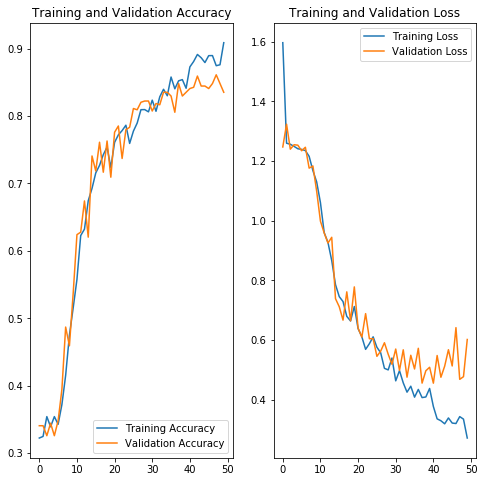

In [21]:
acc = history.history['categorical_accuracy']
val_acc = history.history['val_categorical_accuracy']

loss=history.history['loss']
val_loss=history.history['val_loss']

epochs_range = range(epochs)

plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()



## Creating a second model to not have to save/ mess with above model.

More augmentation to hopefully improve prediction accuracy, reduce overfitting over longer training periods.

In [9]:
fit_x = train_df.path.progress_apply(load_image).values

100%|██████████████████████████████████████████████████████████████████████████████| 1365/1365 [00:39<00:00, 35.05it/s]


In [10]:
fit_x = np.array([i for i in fit_x], dtype='float32')
fit_x.shape

(1365, 215, 215, 3)

path                 images/Train_1799.jpg
healthy                                  1
multiple_diseases                        0
rust                                     0
scab                                     0
Name: 1799, dtype: object


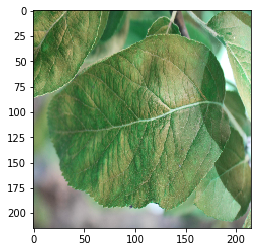

In [11]:
plt.imshow(fit_x[1236].astype(int))
print(train_df.iloc[1236,:])

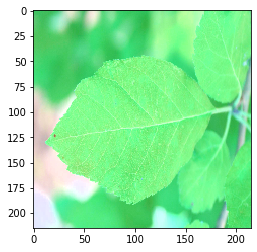

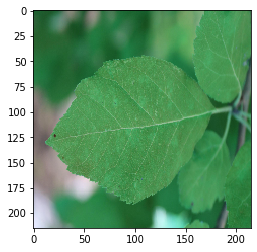

In [15]:

test = fit_x[0]


def increase_brightness(img, value=100):
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    h, s, v = cv2.split(hsv)

    lim = 255 - value
    v[v > lim] = 255
    v[v <= lim] += value

    final_hsv = cv2.merge((h, s, v))
    img = cv2.cvtColor(final_hsv, cv2.COLOR_HSV2BGR)
    return img


temp = increase_brightness(test)
plt.imshow(temp.astype(int))
plt.show()
plt.imshow(test.astype(int))
plt.show()

# cv2.imwrite('augmented/images/testing.png', temp)

In [12]:
labels.drop(columns='image_id', inplace=True)
labels = labels[['path', 'healthy','multiple_diseases','rust','scab']]

In [13]:
labels.head()

,path,healthy,multiple_diseases,rust,scab
0,images/Train_0.jpg,0,0,0,1
1,images/Train_1.jpg,0,1,0,0
2,images/Train_2.jpg,1,0,0,0
3,images/Train_3.jpg,0,0,1,0
4,images/Train_4.jpg,1,0,0,0


In [16]:

class ChannelImageNormalization():
    def __init__(self, fulldataframe, train_dataframe, target_path, trainX):
        """
        @param dataframe: pandas dataframe with labels and image paths
        @param target_path: relative (or absolute) path to directory to store augmented images
        @param trainX: loaded training images (raw images, in cv2 default BGR order)
        """
        self.df = fulldataframe.copy() 
        self.target_path = target_path 
        self.train_dataframe = train_dataframe
        
        # getting first, second, third channel means of training data
        self.blue_mean = trainX[:,:,:,0].mean()
        self.green_mean = trainX[:,:,:,1].mean()
        self.red_mean = trainX[:,:,:,2].mean()
        
        #remove images in target path 
        files = glob.glob('{}/*'.format(target_path))
        for f in files:
            os.remove(f)
            
    def read_img(self, path, imgS):
        image = cv2.imread(path)
        image = cv2.resize(image, (imgS, imgS))
        return image
        
    def sub_mean_(self, image):
        image = image.astype('float64')
        image[:,:,0] -= self.blue_mean
        image[:,:,1] -= self.green_mean
        image[:,:,2] -= self.red_mean
        return image
    def increase_brightness_(self, img, value=30):
        hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
        h, s, v = cv2.split(hsv)

        lim = 255 - value
        v[v > lim] = 255
        v[v <= lim] += value

        final_hsv = cv2.merge((h, s, v))
        img = cv2.cvtColor(final_hsv, cv2.COLOR_HSV2BGR)
        return img
        
    def save_image(self, image, counter):
        path = self.target_path + 'Train_' + str(counter) + '.png'
        cv2.imwrite(path, image)
        return path
        
    def run(self,imageS=256,bright_shift_range=50):
        self.counter = 0
        for index, row in self.df.iterrows():
            image = self.read_img(row[0], imageS)
            label = row[1::]
            if index in self.train_dataframe.index: 
                rand_shift = np.random.randint(high=bright_shift_range,low=0)
                image = self.increase_brightness_(image, value=rand_shift).astype('float64')
            image = self.sub_mean_(image)
            df_path = self.save_image(image, index)
            self.df.iloc[self.counter,0] = 'images/' + 'Train_' + str(index) + '.png'
            self.counter += 1
        return self.df 
        
        
#     image = cv2.imread(path)
#     image = cv2.resize(image, (215, 215))
#     return image / 255.0
#     return cv2.cvtColor(image, cv2.COLOR_BGR2RGB) / 225.0
#     return image


In [17]:
norm = ChannelImageNormalization(labels, train_df, 'augmented/images/',fit_x)
new_labels = norm.run(bright_shift_range=75)

In [18]:
new_labels.head()

,path,healthy,multiple_diseases,rust,scab
0,images/Train_0.png,0,0,0,1
1,images/Train_1.png,0,1,0,0
2,images/Train_2.png,1,0,0,0
3,images/Train_3.png,0,0,1,0
4,images/Train_4.png,1,0,0,0


In [82]:
X = new_labels.loc[:,'path']
y = new_labels.loc[:, labels.columns[1:5]]

X_train, X_test, y_train, y_test = train_test_split(X,y,random_state=42,stratify=y,test_size=0.3)

# zippedtrain = zip(X_train,y_train)
# zippedtest = zip(X_test,y_test)
# train_df = pd.DataFrame({'path':X_train,'class':[list(i) for i in y_train]})
# test_df = pd.DataFrame({'path':X_test,'class':[list(i) for i in y_test]})

train_df = pd.DataFrame(X_train).join(pd.DataFrame(y_train))
test_df = pd.DataFrame(X_test).join(pd.DataFrame(y_test))

train_df.head()

,path,healthy,multiple_diseases,rust,scab
1800,images/Train_1800.png,0,0,0,1
1640,images/Train_1640.png,0,0,1,0
986,images/Train_986.png,0,0,0,1
17,images/Train_17.png,0,0,0,1
186,images/Train_186.png,0,0,0,1


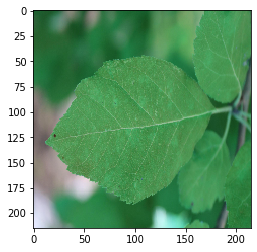

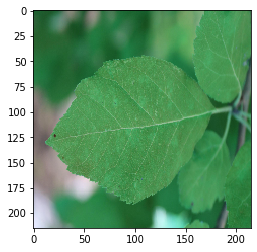

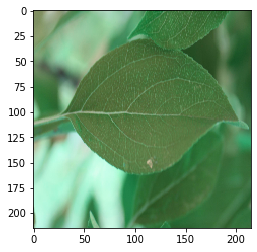

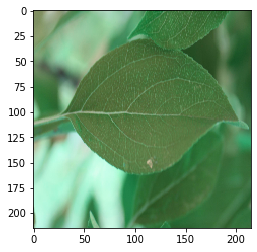

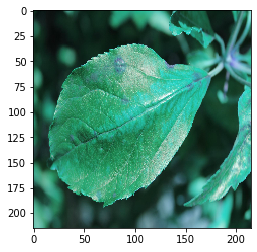

...

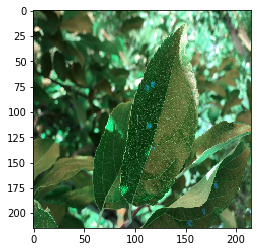

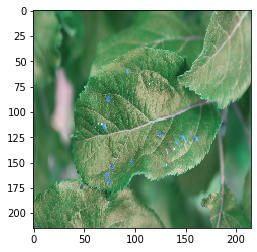

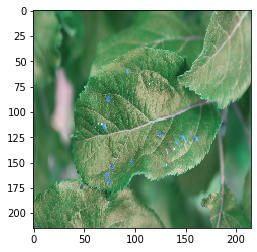

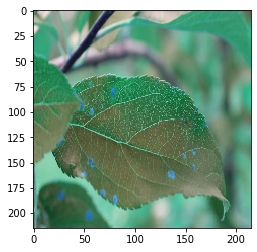

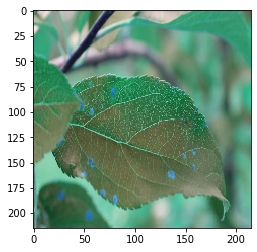

In [20]:
def random_blurr(img):
    go = np.random.randint(0,10)
    if go == 7:
#         num = np.random.randint(10,30)
#         kernel = np.ones((num,num),'float')*( 1.0 / (num*num) )
#         img = cv2.filter2D(img,-1,kernel)
        num = np.random.randint(5,15)
        img = cv2.blur(img, (num,num))
    return img



for i in range(10):
    plt.imshow(fit_x[i].astype(int))
    plt.show()
    temp = random_blurr(fit_x[i])
    plt.imshow(temp.astype(int))
    plt.show()

In [21]:
# creating new data augmentation to hopefully reduce overfitting and get above 85% validation accuracy 


batch = 15

imgH = 256
imgW = 256

image_generator_ = ImageDataGenerator(rescale=1./255, rotation_range=45, width_shift_range=0,
                                    height_shift_range=0, horizontal_flip=True, vertical_flip=True,zoom_range=0,
                                     preprocessing_function=random_blurr)
val_image_gen_ = ImageDataGenerator(rescale=1./255)


valGen_ = val_image_gen_.flow_from_dataframe(test_df,directory='augmented', x_col='path',
                                           y_col=['healthy','multiple_diseases','rust','scab'],
                                          batch_size=batch, class_mode='raw', target_size=(imgH,imgW))

traindataGen_ = image_generator_.flow_from_dataframe(train_df, directory='augmented', x_col='path', 
                                                   y_col=['healthy','multiple_diseases','rust','scab'],
                                                  target_size=(imgH,imgW), batch_size=batch, class_mode='raw')

Found 547 validated image filenames.
Found 1274 validated image filenames.


[0 0 0 1]


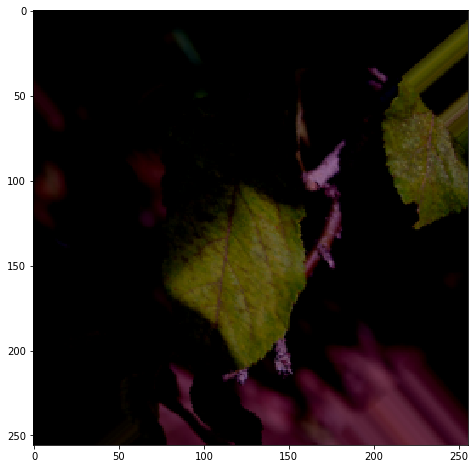

[0 0 1 0]


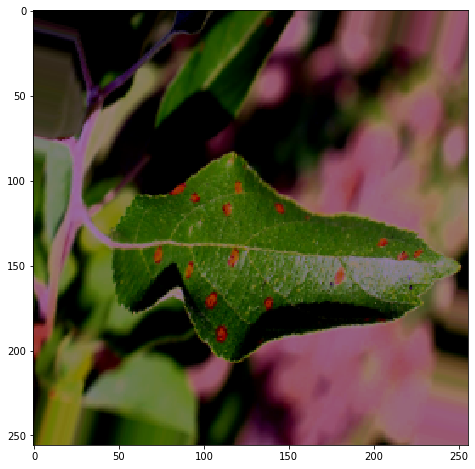

[0 0 1 0]


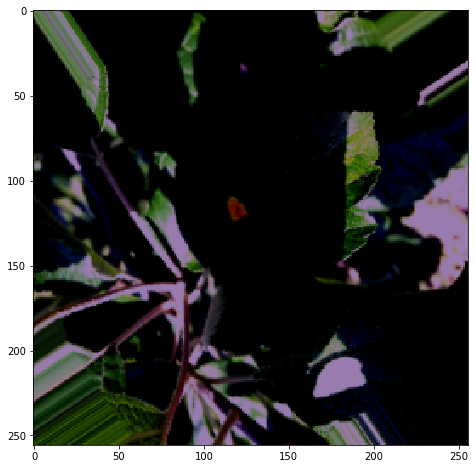

[1 0 0 0]


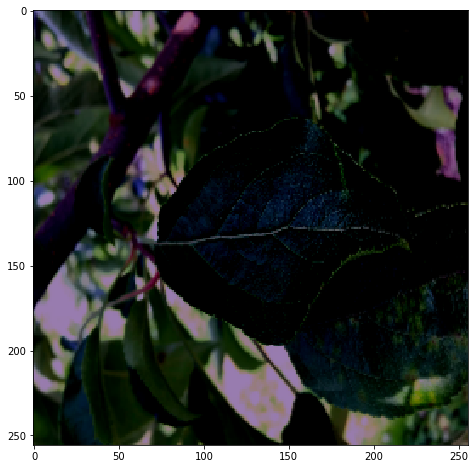

[0 0 1 0]


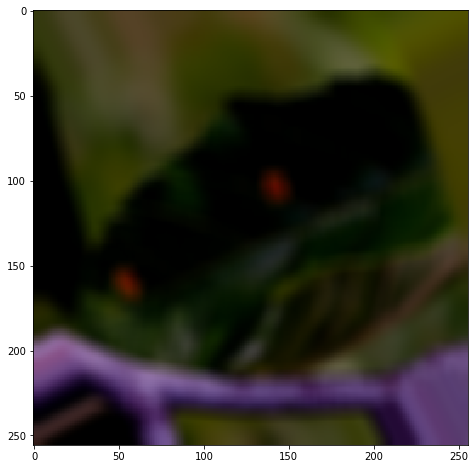

[0 0 1 0]


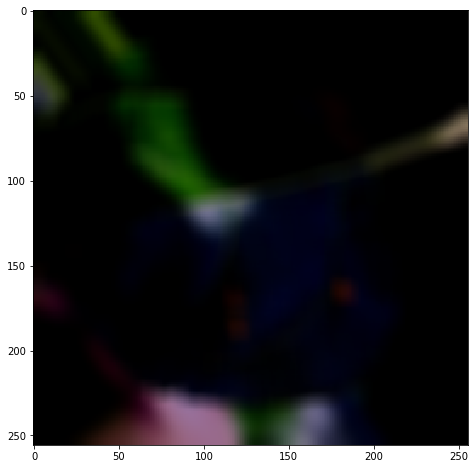

[1 0 0 0]


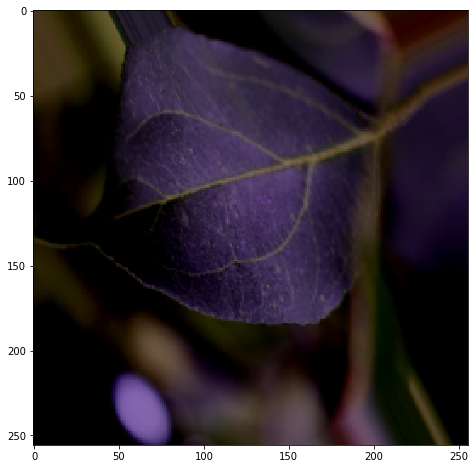

[1 0 0 0]


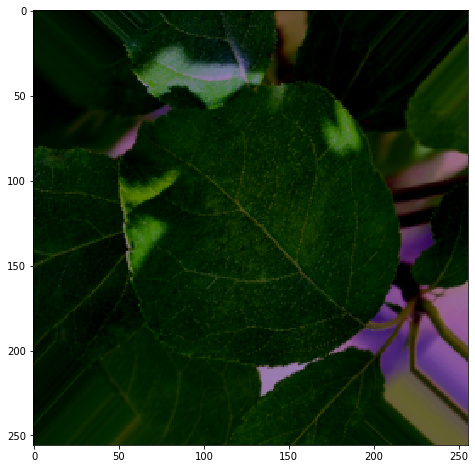

[0 0 1 0]


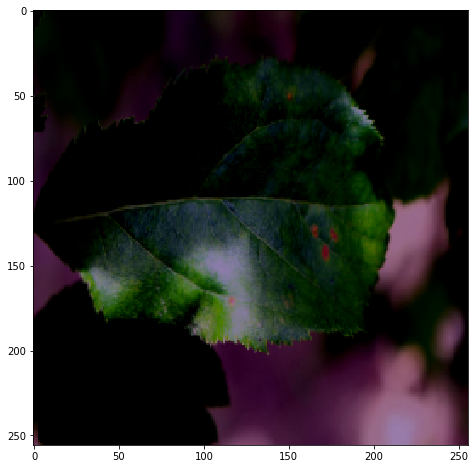

[0 0 0 1]


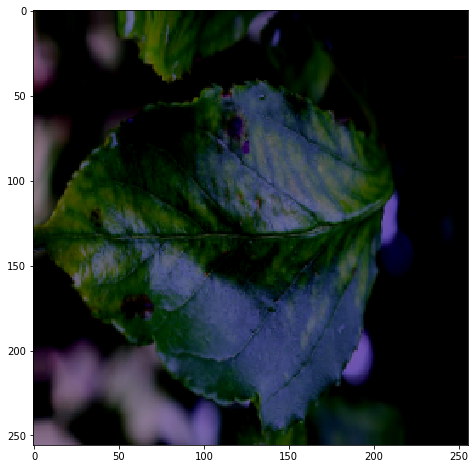

[0 0 1 0]


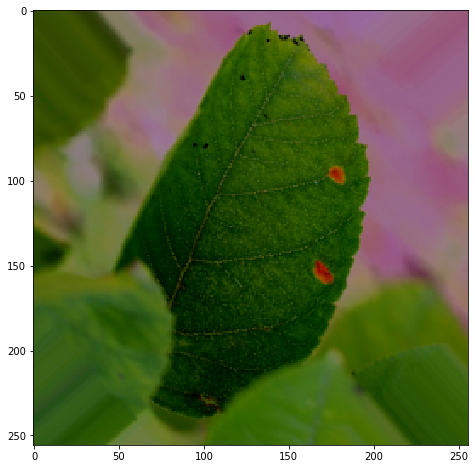

[0 0 0 1]


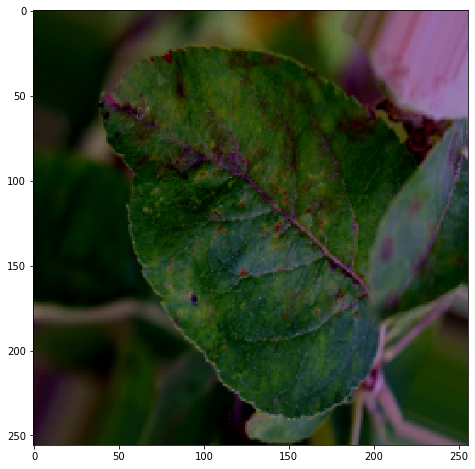

VALID
[0 0 0 1]


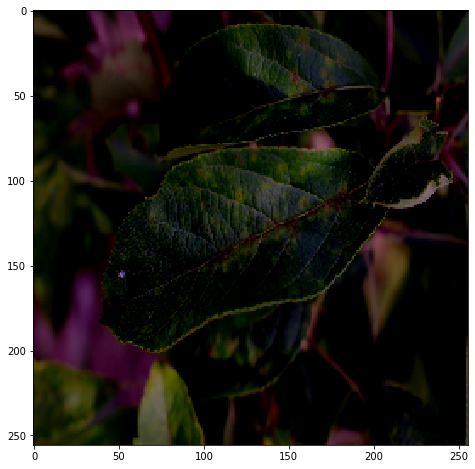

[1 0 0 0]


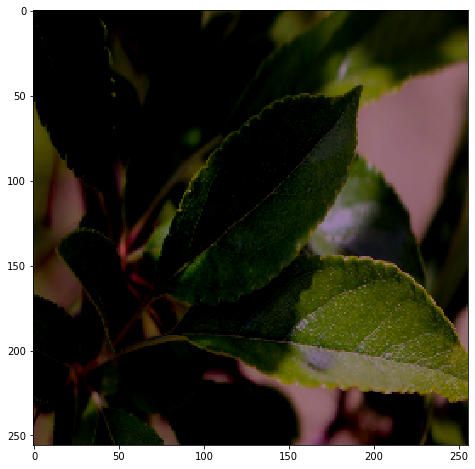

[0 0 0 1]


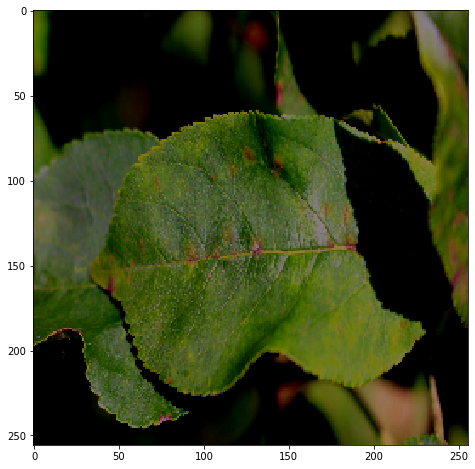

[0 0 1 0]


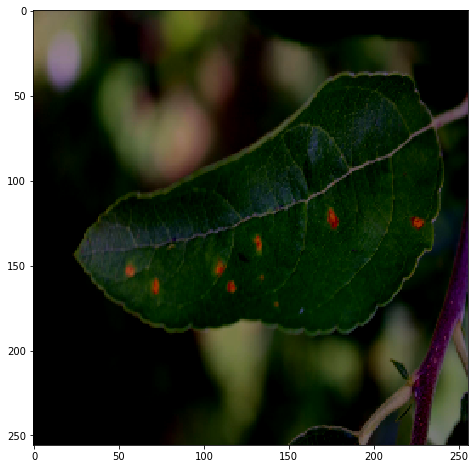

[0 0 0 1]


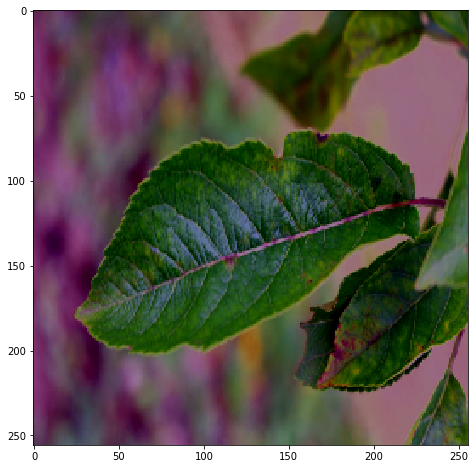

[0 0 1 0]


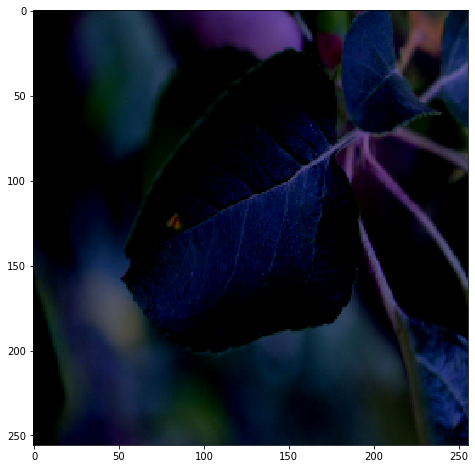

[1 0 0 0]


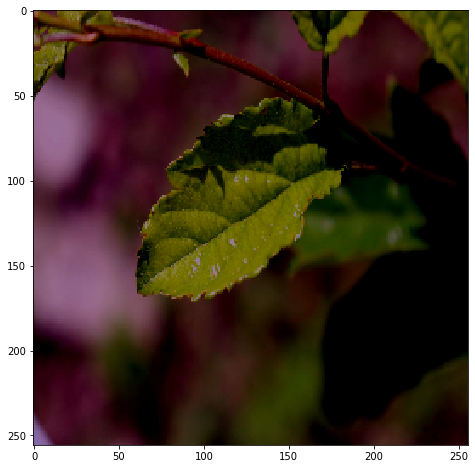

[1 0 0 0]


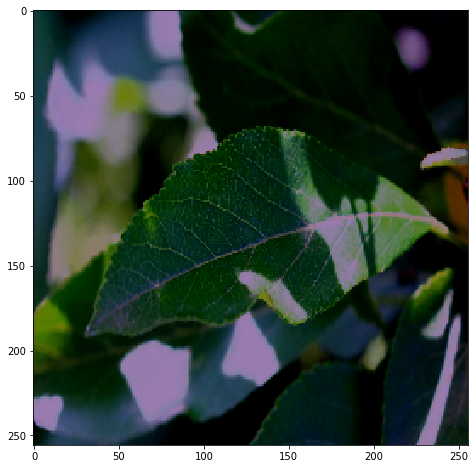

[1 0 0 0]


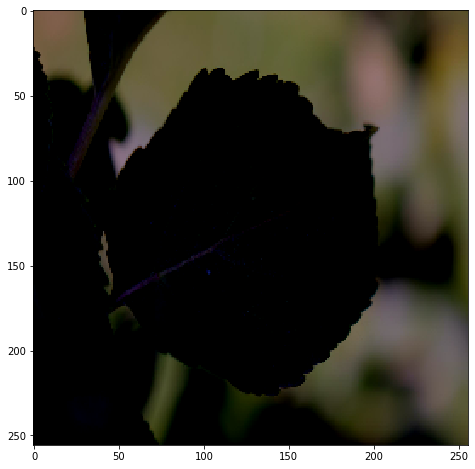

[0 0 0 1]


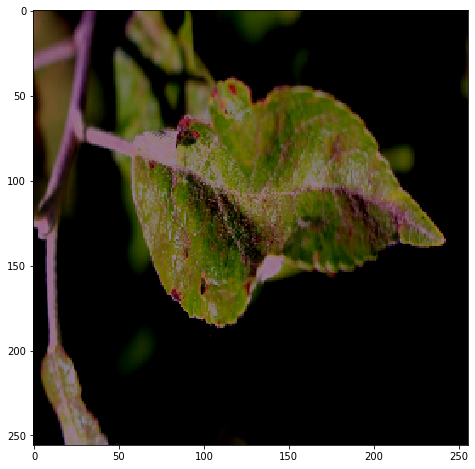

[1 0 0 0]


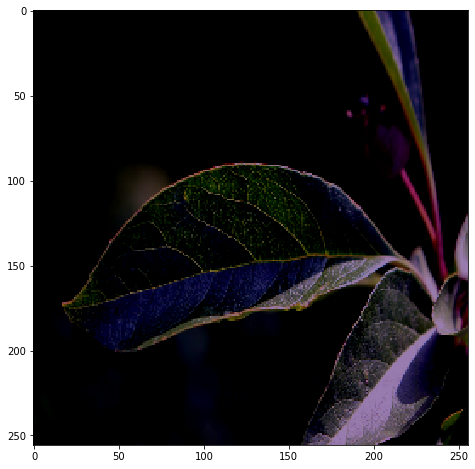

[1 0 0 0]


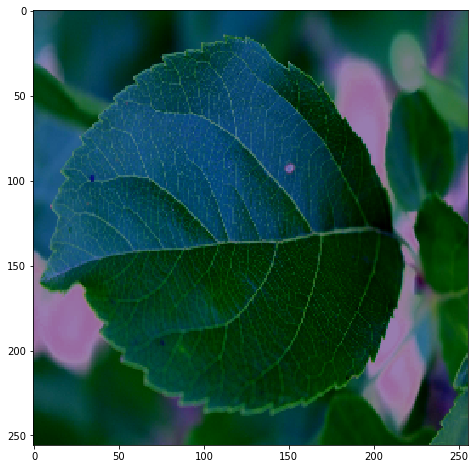

In [22]:
counter = 0
for x, label in traindataGen_:
    
    if counter == 3:
        break
    print(label[1])
    plt.figure(figsize=(8,8))
    plt.imshow(x[1])
    plt.show()
    print(label[2])
    plt.figure(figsize=(8,8))
    plt.imshow(x[2])
    plt.show()
    print(label[3])
    plt.figure(figsize=(8,8))
    plt.imshow(x[3])
    plt.show()
    print(label[4])
    plt.figure(figsize=(8,8))
    plt.imshow(x[4])
    plt.show()
    counter += 1
    
counter = 0
print('VALID')
print('='*100)
for x, label in valGen_:
    
    if counter == 3:
        break
    print(label[1])
    plt.figure(figsize=(8,8))
    plt.imshow(x[1])
    plt.show()
    print(label[2])
    plt.figure(figsize=(8,8))
    plt.imshow(x[2])
    plt.show()
    print(label[3])
    plt.figure(figsize=(8,8))
    plt.imshow(x[3])
    plt.show()
    print(label[4])
    plt.figure(figsize=(8,8))
    plt.imshow(x[4])
    plt.show()
    counter += 1

In [23]:
#fitting a second model with higher resolution and more augmented images, more epochs
#Wanted more filters in last conv output but too large of network for my maching 
#will be building deeper network in colab
#having to reduce batch size for GPU memory
# tf.reset_default_graph()

model2 = models.Sequential()
model2.add(layers.Conv2D(filters=16,kernel_size=(3,3), activation='relu', input_shape=(imgH, imgW,3), padding='valid',
                       data_format='channels_last'))
model2.add(layers.MaxPooling2D())
model2.add(layers.Dropout(0.1))
model2.add(layers.Conv2D(32, (3,3), activation='relu', padding='valid'))
model2.add(layers.MaxPooling2D())
model2.add(layers.Dropout(0.1))
model2.add(layers.Conv2D(32, (3,3), activation='relu', padding='same'))
model2.add(layers.MaxPooling2D())
model2.add(layers.Dropout(0.1))
model2.add(layers.Conv2D(64, (3,3), activation='relu', padding='same',dilation_rate=2))
model2.add(layers.MaxPooling2D())
model2.add(layers.Dropout(0.1))

model2.add(layers.Flatten())
model2.add(layers.Dense(256, activation='relu'))
model2.add(layers.Dense(256, activation='elu'))
model2.add(layers.Dense(y_train.shape[1], activation='softmax'))

model2.summary()





STEP_SIZE_TRAIN=traindataGen_.n//traindataGen_.batch_size
STEP_SIZE_VALID=valGen_.n//valGen_.batch_size


epochs = 75
model2.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=.0001),
             loss='categorical_crossentropy',
             metrics=['categorical_accuracy'])

history2 = model2.fit_generator(generator=traindataGen_, 
                              epochs=epochs,
                   validation_data=valGen_,steps_per_epoch=STEP_SIZE_TRAIN,validation_steps=STEP_SIZE_VALID, verbose=2)

Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 254, 254, 16)      448       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 127, 127, 16)      0         
_________________________________________________________________
dropout (Dropout)            (None, 127, 127, 16)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 125, 125, 32)      4640      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 62, 62, 32)        0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 62, 62, 32)        0         
____

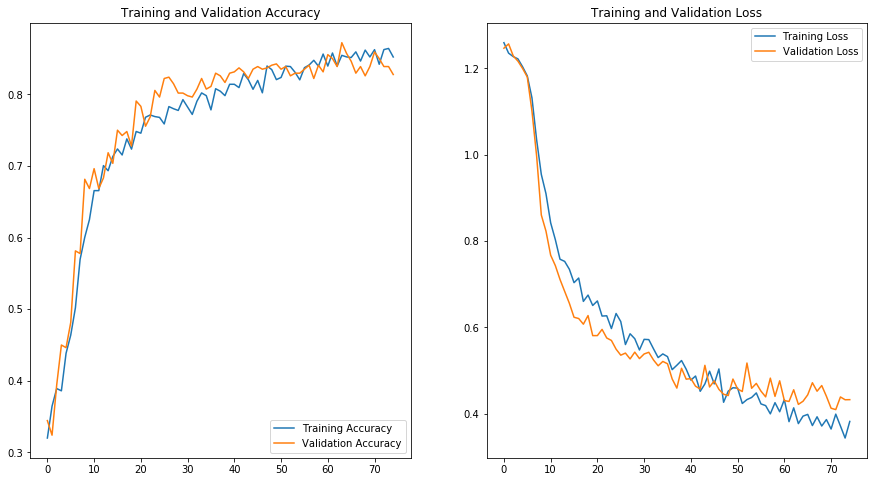

In [24]:
acc = history2.history['categorical_accuracy']
val_acc = history2.history['val_categorical_accuracy']

loss=history2.history['loss']
val_loss=history2.history['val_loss']

epochs_range = range(epochs)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()



In [70]:
def load_aug_val(path):
    path_ = 'augmented/' + path
    img = cv2.imread(path_)
    img= cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
    return np.float32(np.float64(img) / 255)
val_images = test_df.path.progress_apply(load_aug_val).values
val_images = np.array([i for i in val_images])
predictions = model2.predict(val_images)


100%|███████████████████████████████████████████████████████████████████████████████| 547/547 [00:01<00:00, 277.35it/s]

In [72]:
label_array = labels.columns[1::]

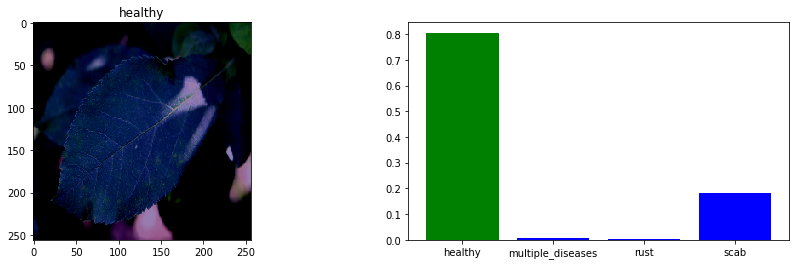

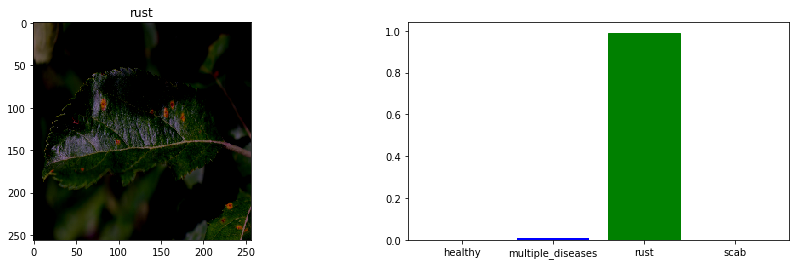

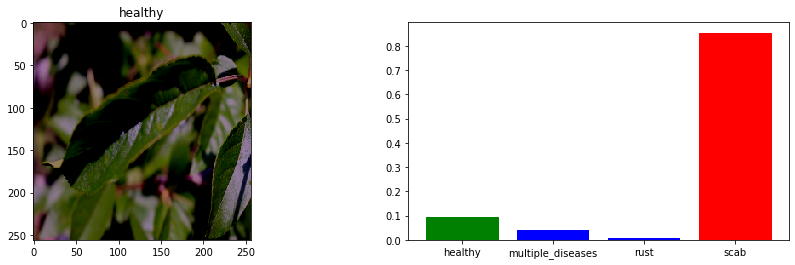

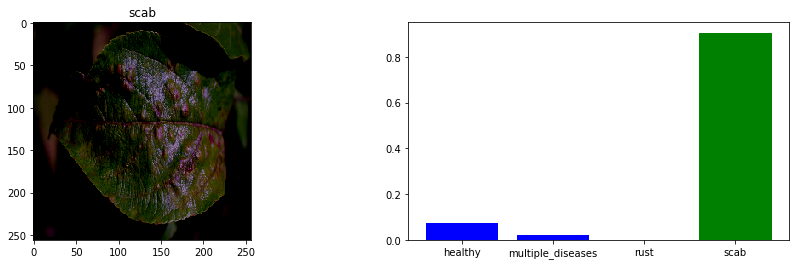

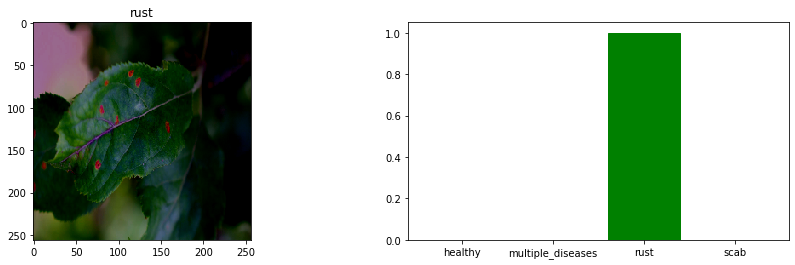

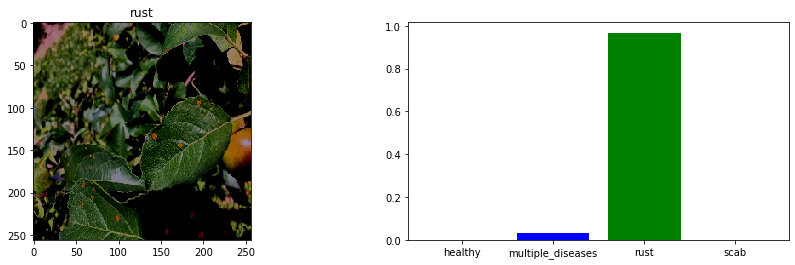

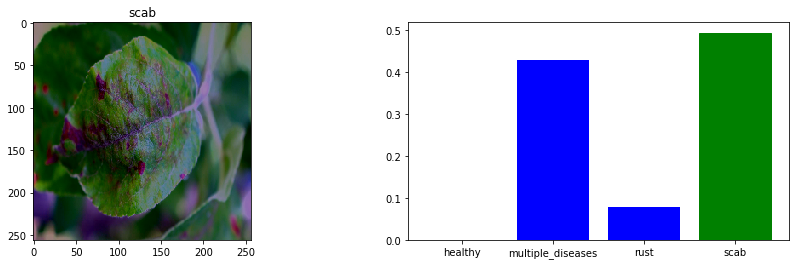

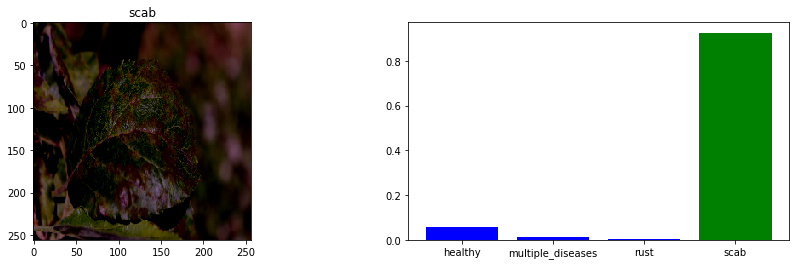

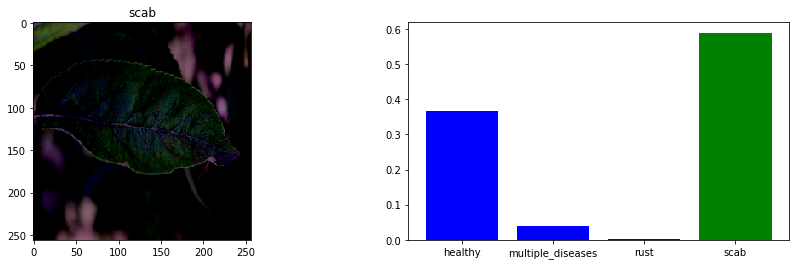

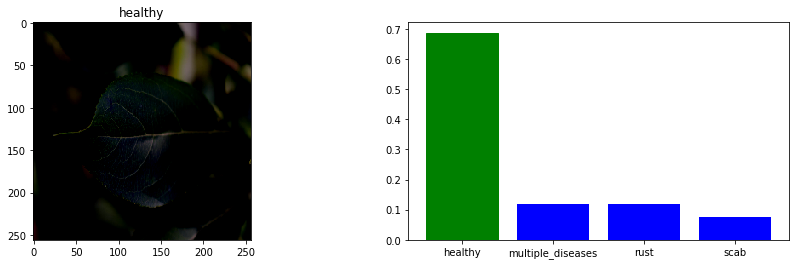

In [73]:
plot_imgs = val_images.copy()
tru_labels = y_test.values
counter = 0
while counter <= 9:
    index = np.random.randint(low=0, high=len(plot_imgs), size=1)
    img_predicted_on = plot_imgs[index][0]
    full_img_path = test_df.path.values[index]
    full_img_path = full_img_path[0].split('.')[0] + '.jpg'
    img = cv2.imread(full_img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    pred_array = predictions[index]
    pred_class = label_array[np.argmax(pred_array)]
    
    tru_class = label_array[np.argmax(tru_labels[index])]
#     if tru_class in ['healthy','rust']:
#         continue
    f, ax = plt.subplots(nrows=1, ncols=2, figsize=(15,4))
    if pred_class == tru_class:
        pred_color = 'g'
        tru_color = 'g'
    else:
        pred_color = 'r'
        tru_color = 'g'
        
    ax[0].imshow(img_predicted_on)
    ax[0].set_title('{}'.format(tru_class))
    bar = ax[1].bar(label_array, pred_array[0], color='b')
    bar[np.argmax(pred_array)].set_color(pred_color)
    bar[np.argmax(tru_labels[index])].set_color(tru_color)
    counter += 1

    
plt.show()

In [74]:
accuracy = model2.evaluate(val_images, y_test)

547/547 [==============================] - ETA: 1s - loss: 0.4005 - categorical_accuracy: 0.81 - ETA: 1s - loss: 0.4903 - categorical_accuracy: 0.81 - ETA: 1s - loss: 0.4994 - categorical_accuracy: 0.77 - ETA: 0s - loss: 0.4184 - categorical_accuracy: 0.82 - ETA: 0s - loss: 0.4555 - categorical_accuracy: 0.83 - ETA: 0s - loss: 0.4558 - categorical_accuracy: 0.82 - ETA: 0s - loss: 0.4769 - categorical_accuracy: 0.80 - ETA: 0s - loss: 0.4586 - categorical_accuracy: 0.81 - ETA: 0s - loss: 0.4413 - categorical_accuracy: 0.82 - ETA: 0s - loss: 0.4306 - categorical_accuracy: 0.83 - ETA: 0s - loss: 0.4434 - categorical_accuracy: 0.82 - ETA: 0s - loss: 0.4572 - categorical_accuracy: 0.81 - ETA: 0s - loss: 0.4515 - categorical_accuracy: 0.82 - ETA: 0s - loss: 0.4317 - categorical_accuracy: 0.83 - ETA: 0s - loss: 0.4297 - categorical_accuracy: 0.83 - ETA: 0s - loss: 0.4199 - categorical_accuracy: 0.83 - ETA: 0s - loss: 0.4273 - categorical_accuracy: 0.83 - 1s 2ms/sample - loss: 0.4290 - categori

In [75]:
accuracy


[0.4289767633190539, 0.82998174]

In [76]:
model2.save('saved_model/model2')

In [78]:
test_model = tf.keras.models.load_model('saved_model/model2')
accuracy = test_model.evaluate(val_images, y_test)

Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
547/547 [==============================] - ETA: 2s - loss: 0.4005 - categorical_accuracy: 0.81 - ETA: 1s - loss: 0.4903 - categorical_accuracy: 0.81 - ETA: 1s - loss: 0.4994 - categorical_accuracy: 0.77 - ETA: 1s - loss: 0.4184 - categorical_accuracy: 0.82 - ETA: 1s - loss: 0.4555 - categorical_accuracy: 0.83 - ETA: 0s - loss: 0.4558 - categorical_accuracy: 0.82 - ETA: 0s - loss: 0.4769 - categorical_accuracy: 0.80 - ETA: 0s - loss: 0.4586 - categorical_accuracy: 0.81 - ETA: 0s - loss: 0.4413 - categorical_accuracy: 0.82 - ETA: 0s - loss: 0.4306 - categorical_accuracy: 0.83 - ETA: 0s - loss: 0.4434 - categorical_accuracy: 0.82 - ETA: 0s - loss: 0.4572 - categorical_accuracy: 0.81 - ETA: 0s - loss: 0.4515 - categorical_accuracy: 0.82 - ETA: 0s - loss: 0.4

In [79]:
accuracy

[0.4289767633190539, 0.82998174]